## Notebook 2 - Exploratory Data Analysis
### Project 3 | DSI 523 | Adriana J. Machado 
-----

## Table of Contents
### [4.0 Exploratory Data Analysis](#4.0-Exploratory-Data-Analysis)
### [4.1 Sentiment Analysis](#4.1-Sentiment-Analysis)
> ### [4.1.2 Sentiment Analysis Visualizations](#4.1.2-Sentiment-Analysis-Visualizations)
### [4.2 CountVectorizer](#4.2-Count-Vectorizor)
> ### [4.2.1 Most Frequent Words For Shower Thoughts](#4.2.1-Most-Frequent-Words-For-Shower-Thoughts)
>> ### [4.2.1.1 Most Frequent Words For Shower Thought](#4.2.1.1-Most-Frequent-Words-For-Shower-Thought)
>> ### [4.2.1.2 Most Frequent Bigrams For Shower Thoughts](#4.2.1.2-Most-Frequent-Bigrams-For-Shower-Thoughts)
> ### [4.2.2 Most Frequent Words For Intrusive Thoughts](#4.2.2-Most-Frequent-Words-For-Intrusive-Thoughts)
>> ### [4.2.2.1 Most Frequent Words For Intrusive Thoughts](#4.2.2.1-Most-Frequent-Words-For-Intrusive-Thoughts)
>> ### [4.2.2.2 Most Frequent Bigrams For Intrusive Thoughts](#4.2.2.2-Most-Frequent-Bigrams-For-Intrusive-Thoughts)
### [4.3 Term Frequency-Inverse Document Frequency Vectorizer](#4.3-Term-Frequency-Inverse-Document-Frequency)
> ### [4.3.2 TFIDF on Shower Thoughts](#4.3.2-TFIDF-on-Shower-Thought)
>> ### [4.3.2.1 TFIDF Shower Thoughts Words](#4.3.2.1-TFIDF-Shower-Thoughts-Words)
>> ### [4.3.2.2 TFIDF Shower Thoughts Bigrams](#4.3.2.2-TFIDF-Shower-Thoughts-Bigrams)
> ### [4.3.3 TFIDF on Intrusive Thoughts](#4.3.3-TFIDF-on-Intrusive-Thoughts)
>> ### [4.3.3.1 TFIDIF Intrusive Thoughts Words](#4.3.3.1-TFIDIF-Intrusive-Thoughts-Words)
>> ### [4.3.3.2 TFIDF Intrusive Thoughts Bigrams](#4.3.3.2-TFIDF-Intrusive-Thoughts-Bigrams)
### [4.4 Save TVecs and Intrusive Shower Final](#4.4-Save-TVecs-and-Intrusive-Shower-Final)
-----

# 4.0 Exploratory Data Analysis
-----
The following is the code used to arrive at conclusions about Shower Thoughts and Intrusive Thoughts.

To Summarize:
- (Section 4.1) After conducting a sentiment analysis on the stored dataset of subreddit data,
>- Shower Thoughts is a little more than neutral in compound sentiment (0.011) with a large amount of posts in the neutral category and a pretty even spread among negative and positive. 
>- Intrusive Thoughts is pretty negative (-0.204); mostly with negative posts but also with a large amount in neutral. 
- (Sections 4.2 & 4.3) A CountVectorizor and TFIDF Vectorizer were conducted on words and bigrams for both subreddits. 
- (Section 4.4) The TIFIDF Vectorizer process was chosen to extract common words and bigrams from both subreddits (to potentially be used), due to the extraction not just taking a count of words, but also taking into consideration the spread of the words across posts. The large amount of different 'documents' or rows of posts makes TFIDF a better approach by accounting for frequency and uniqueness. 

## Imports

In [70]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Lesson 5.04
from nltk.tokenize import sent_tokenize, word_tokenize, RegexpTokenizer
from nltk.corpus import stopwords
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import re

from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

# warnings
import warnings
warnings.simplefilter("ignore")
import warnings
with warnings.catch_warnings():
    warnings.filterwarnings("ignore", category=DeprecationWarning)

# formatting
pd.set_option('display.max_columns', None)
pd.options.display.max_colwidth = 400

In [71]:
## Import intrusive_shower_clean
intrusive_shower = pd.read_csv('./data/intrusive_shower_clean.csv')
intrusive_shower['selftext'] = intrusive_shower['selftext'].fillna('redacted')

print(intrusive_shower.shape)
intrusive_shower.head()

(5994, 10)


,is_shower,subreddit,created_utc,title,selftext,upvote_ratio,title_token,selftext_token,title_no_stop,selftext_no_stop
0,0,intrusivethoughts,1656469973,i am extremely scared my left eye is moving slowly downwards on my face,redacted,1.0,"['i', 'am', 'extremely', 'scared', 'my', 'left', 'eye', 'is', 'moving', 'slowly', 'downwards', 'on', 'my', 'face']",['redacted'],"['i', 'am', 'extremely', 'scared', 'my', 'left', 'eye', 'is', 'moving', 'slowly', 'downwards', 'on', 'my', 'face']",['redacted']
1,0,intrusivethoughts,1656468826,here's a list of my intrusive thoughts,jump in front of a car run people over go knife happy throw water over electrics shout racial abuse shoot a school up why is my brain doing this to me!!!!! 😢😢😢😢,1.0,"['here', ""'s"", 'a', 'list', 'of', 'my', 'intrusive', 'thoughts']","['jump', 'in', 'front', 'of', 'a', 'car', 'run', 'people', 'over', 'go', 'knife', 'happy', 'throw', 'water', 'over', 'electrics', 'shout', 'racial', 'abuse', 'shoot', 'a', 'school', 'up', 'why', 'is', 'my', 'brain', 'doing', 'this', 'to', 'me', '!!!!!', '😢😢😢😢']","['here', ""'s"", 'a', 'list', 'of', 'my', 'intrusive', 'thoughts']","['jump', 'in', 'front', 'of', 'a', 'car', 'run', 'people', 'over', 'go', 'knife', 'happy', 'throw', 'water', 'over', 'electrics', 'shout', 'racial', 'abuse', 'shoot', 'a', 'school', 'up', 'why', 'is', 'my', 'brain', 'doing', 'this', 'to', 'me', '!!!!!', '😢😢😢😢']"
2,0,intrusivethoughts,1656464538,step on your cat,"i love her so much but....she's just lying there, in the way ... could i crush her scull?",1.0,"['step', 'on', 'your', 'cat']","['i', 'love', 'her', 'so', 'much', 'but', ""....she's"", 'just', 'lying', 'there', ',', 'in', 'the', 'way', '...', 'could', 'i', 'crush', 'her', 'scull', '?']","['step', 'on', 'your', 'cat']","['i', 'love', 'her', 'so', 'much', 'but', ""....she's"", 'just', 'lying', 'there', ',', 'in', 'the', 'way', '...', 'could', 'i', 'crush', 'her', 'scull', '?']"
3,0,intrusivethoughts,1656459837,intrusive thoughts,are paranoid intrusive thoughts a thing??,1.0,"['intrusive', 'thoughts']","['are', 'paranoid', 'intrusive', 'thoughts', 'a', 'thing', '??']","['intrusive', 'thoughts']","['are', 'paranoid', 'intrusive', 'thoughts', 'a', 'thing', '??']"
4,0,intrusivethoughts,1656458075,bash your head against the painting and cut your eyes out with the glass,aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh do it now! do it right fucking now aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh,1.0,"['bash', 'your', 'head', 'against', 'the', 'painting', 'and', 'cut', 'your', 'eyes', 'out', 'with', 'the', 'glass']","['aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh', 'do', 'it', 'now', '!', 'do', 'it', 'right', 'fucking', 'now', 'aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh']","['bash', 'your', 'head', 'against', 'the', 'painting', 'and', 'cut', 'your', 'eyes', 'out', 'with', 'the', 'glass']","['aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh', 'do', 'it', 'now', '!', 'do', 'it', 'right', 'fucking', 'now', 'aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh']"


# 4.1 Sentiment Analysis
-----
## Adapted from Lesson 5.04

In [3]:
sent = SentimentIntensityAnalyzer()

### Create Compound Sentimental Analysis Score Column for Title

In [4]:
sent.polarity_scores(intrusive_shower['title'][3])['compound']

0.0

In [5]:
intrusive_shower['title_sent'] = [sent.polarity_scores(title)['compound'] for title in intrusive_shower['title']]

In [6]:
# intrusive_shower.head()

### Create Compound Sentimental Analysis Score Column for Self Text

In [7]:
sent.polarity_scores(intrusive_shower['selftext'][1])['compound']

-0.6209

In [8]:
intrusive_shower['selftext_sent'] = [sent.polarity_scores(title)['compound'] for title in intrusive_shower['selftext']]

In [9]:
# intrusive_shower.head()

### Create Overall Compound Score Scolumn with Title and Self Text Compound Scores

In [10]:
# intrusive_shower.head()

In [11]:
# If one score is not available, takes the available score. If both are available, takes the average of the two.

intrusive_shower['overall_sent'] = float

for i in range(len(intrusive_shower)):
    
    if (intrusive_shower['selftext_sent'][i] == 0) & (intrusive_shower['title_sent'][i] != 0):
        intrusive_shower['overall_sent'][i] = intrusive_shower['title_sent'][i]
    
    elif (intrusive_shower['title_sent'][i] == 0) & (intrusive_shower['selftext_sent'][i] != 0):
        intrusive_shower['overall_sent'][i] = intrusive_shower['selftext_sent'][i]
    
    else:
        intrusive_shower['overall_sent'][i] = (intrusive_shower['selftext_sent'][i] 
                                            + intrusive_shower['title_sent'][i]) / 2

In [12]:
intrusive_shower.head()

,is_shower,subreddit,created_utc,title,selftext,upvote_ratio,title_token,selftext_token,title_no_stop,selftext_no_stop,title_sent,selftext_sent,overall_sent
0,0,intrusivethoughts,1656469973,i am extremely scared my left eye is moving slowly downwards on my face,redacted,1.0,"['i', 'am', 'extremely', 'scared', 'my', 'left', 'eye', 'is', 'moving', 'slowly', 'downwards', 'on', 'my', 'face']",['redacted'],"['i', 'am', 'extremely', 'scared', 'my', 'left', 'eye', 'is', 'moving', 'slowly', 'downwards', 'on', 'my', 'face']",['redacted'],-0.4927,0.0000,-0.4927
1,0,intrusivethoughts,1656468826,here's a list of my intrusive thoughts,jump in front of a car run people over go knife happy throw water over electrics shout racial abuse shoot a school up why is my brain doing this to me!!!!! 😢😢😢😢,1.0,"['here', ""'s"", 'a', 'list', 'of', 'my', 'intrusive', 'thoughts']","['jump', 'in', 'front', 'of', 'a', 'car', 'run', 'people', 'over', 'go', 'knife', 'happy', 'throw', 'water', 'over', 'electrics', 'shout', 'racial', 'abuse', 'shoot', 'a', 'school', 'up', 'why', 'is', 'my', 'brain', 'doing', 'this', 'to', 'me', '!!!!!', '😢😢😢😢']","['here', ""'s"", 'a', 'list', 'of', 'my', 'intrusive', 'thoughts']","['jump', 'in', 'front', 'of', 'a', 'car', 'run', 'people', 'over', 'go', 'knife', 'happy', 'throw', 'water', 'over', 'electrics', 'shout', 'racial', 'abuse', 'shoot', 'a', 'school', 'up', 'why', 'is', 'my', 'brain', 'doing', 'this', 'to', 'me', '!!!!!', '😢😢😢😢']",0.0000,-0.6209,-0.6209
2,0,intrusivethoughts,1656464538,step on your cat,"i love her so much but....she's just lying there, in the way ... could i crush her scull?",1.0,"['step', 'on', 'your', 'cat']","['i', 'love', 'her', 'so', 'much', 'but', ""....she's"", 'just', 'lying', 'there', ',', 'in', 'the', 'way', '...', 'could', 'i', 'crush', 'her', 'scull', '?']","['step', 'on', 'your', 'cat']","['i', 'love', 'her', 'so', 'much', 'but', ""....she's"", 'just', 'lying', 'there', ',', 'in', 'the', 'way', '...', 'could', 'i', 'crush', 'her', 'scull', '?']",0.0000,0.0516,0.0516
3,0,intrusivethoughts,1656459837,intrusive thoughts,are paranoid intrusive thoughts a thing??,1.0,"['intrusive', 'thoughts']","['are', 'paranoid', 'intrusive', 'thoughts', 'a', 'thing', '??']","['intrusive', 'thoughts']","['are', 'paranoid', 'intrusive', 'thoughts', 'a', 'thing', '??']",0.0000,-0.3313,-0.3313
4,0,intrusivethoughts,1656458075,bash your head against the painting and cut your eyes out with the glass,aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh do it now! do it right fucking now aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh,1.0,"['bash', 'your', 'head', 'against', 'the', 'painting', 'and', 'cut', 'your', 'eyes', 'out', 'with', 'the', 'glass']","['aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh', 'do', 'it', 'now', '!', 'do', 'it', 'right', 'fucking', 'now', 'aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh']","['bash', 'your', 'head', 'against', 'the', 'painting', 'and', 'cut', 'your', 'eyes', 'out', 'with', 'the', 'glass']","['aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh', 'do', 'it', 'now', '!', 'do', 'it', 'right', 'fucking', 'now', 'aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh']",-0.2732,0.0000,-0.2732


### Save CSV with sentiment analysis compound scores - intrusive_shower_clean_sent.csv

In [13]:
intrusive_shower.to_csv('./data/intrusive_shower_clean_sent.csv', index = False)

## 4.1.2 Sentiment Analysis Visualizations

In [14]:
intrusive_shower.head()

,is_shower,subreddit,created_utc,title,selftext,upvote_ratio,title_token,selftext_token,title_no_stop,selftext_no_stop,title_sent,selftext_sent,overall_sent
0,0,intrusivethoughts,1656469973,i am extremely scared my left eye is moving slowly downwards on my face,redacted,1.0,"['i', 'am', 'extremely', 'scared', 'my', 'left', 'eye', 'is', 'moving', 'slowly', 'downwards', 'on', 'my', 'face']",['redacted'],"['i', 'am', 'extremely', 'scared', 'my', 'left', 'eye', 'is', 'moving', 'slowly', 'downwards', 'on', 'my', 'face']",['redacted'],-0.4927,0.0000,-0.4927
1,0,intrusivethoughts,1656468826,here's a list of my intrusive thoughts,jump in front of a car run people over go knife happy throw water over electrics shout racial abuse shoot a school up why is my brain doing this to me!!!!! 😢😢😢😢,1.0,"['here', ""'s"", 'a', 'list', 'of', 'my', 'intrusive', 'thoughts']","['jump', 'in', 'front', 'of', 'a', 'car', 'run', 'people', 'over', 'go', 'knife', 'happy', 'throw', 'water', 'over', 'electrics', 'shout', 'racial', 'abuse', 'shoot', 'a', 'school', 'up', 'why', 'is', 'my', 'brain', 'doing', 'this', 'to', 'me', '!!!!!', '😢😢😢😢']","['here', ""'s"", 'a', 'list', 'of', 'my', 'intrusive', 'thoughts']","['jump', 'in', 'front', 'of', 'a', 'car', 'run', 'people', 'over', 'go', 'knife', 'happy', 'throw', 'water', 'over', 'electrics', 'shout', 'racial', 'abuse', 'shoot', 'a', 'school', 'up', 'why', 'is', 'my', 'brain', 'doing', 'this', 'to', 'me', '!!!!!', '😢😢😢😢']",0.0000,-0.6209,-0.6209
2,0,intrusivethoughts,1656464538,step on your cat,"i love her so much but....she's just lying there, in the way ... could i crush her scull?",1.0,"['step', 'on', 'your', 'cat']","['i', 'love', 'her', 'so', 'much', 'but', ""....she's"", 'just', 'lying', 'there', ',', 'in', 'the', 'way', '...', 'could', 'i', 'crush', 'her', 'scull', '?']","['step', 'on', 'your', 'cat']","['i', 'love', 'her', 'so', 'much', 'but', ""....she's"", 'just', 'lying', 'there', ',', 'in', 'the', 'way', '...', 'could', 'i', 'crush', 'her', 'scull', '?']",0.0000,0.0516,0.0516
3,0,intrusivethoughts,1656459837,intrusive thoughts,are paranoid intrusive thoughts a thing??,1.0,"['intrusive', 'thoughts']","['are', 'paranoid', 'intrusive', 'thoughts', 'a', 'thing', '??']","['intrusive', 'thoughts']","['are', 'paranoid', 'intrusive', 'thoughts', 'a', 'thing', '??']",0.0000,-0.3313,-0.3313
4,0,intrusivethoughts,1656458075,bash your head against the painting and cut your eyes out with the glass,aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh do it now! do it right fucking now aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh,1.0,"['bash', 'your', 'head', 'against', 'the', 'painting', 'and', 'cut', 'your', 'eyes', 'out', 'with', 'the', 'glass']","['aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh', 'do', 'it', 'now', '!', 'do', 'it', 'right', 'fucking', 'now', 'aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh']","['bash', 'your', 'head', 'against', 'the', 'painting', 'and', 'cut', 'your', 'eyes', 'out', 'with', 'the', 'glass']","['aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh', 'do', 'it', 'now', '!', 'do', 'it', 'right', 'fucking', 'now', 'aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh']",-0.2732,0.0000,-0.2732


In [15]:
intrusive_shower['subreddit'].value_counts()

intrusivethoughts    3000
showerthoughts       2994
Name: subreddit, dtype: int64

### Average Sentiment in Shower Thoughts and Intrusive Thoughts

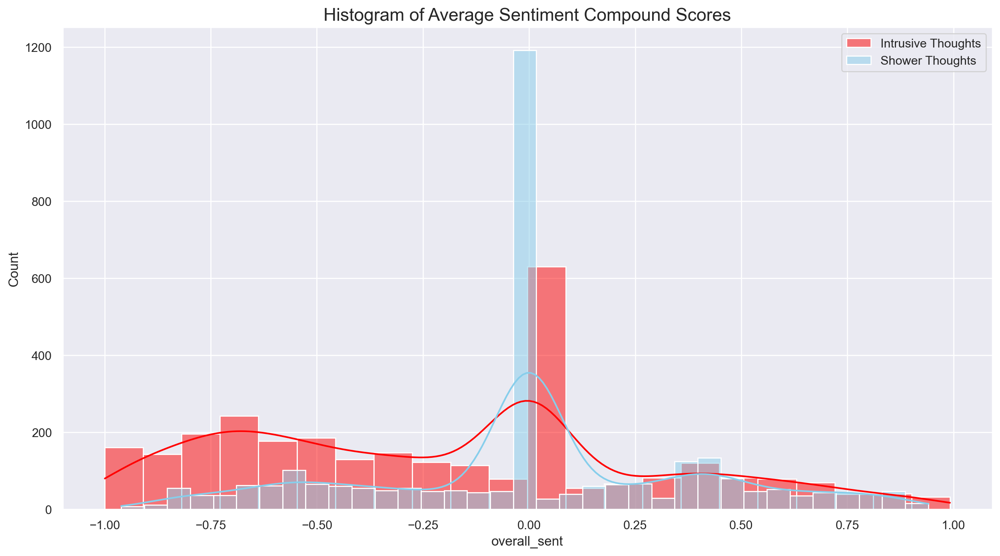

In [16]:
plt.figure(figsize = (15,8), dpi = 200)
sns.set(style="darkgrid")

sns.histplot(data = intrusive_shower[intrusive_shower['subreddit'] == 'intrusivethoughts'], 
             x = "overall_sent", 
             color = "red", 
             label="Intrusive Thoughts", 
             kde=True)

sns.histplot(data = intrusive_shower[intrusive_shower['subreddit'] == 'showerthoughts'], 
             x = "overall_sent", 
             color = "skyblue", 
             label = "Shower Thoughts", 
             kde = True)

plt.title('Histogram of Average Sentiment Compound Scores', fontdict = {'fontsize': 16})
plt.legend() 
plt.savefig('./images/sentiment_hist.png', dpi = 200, bbox_inches='tight')
plt.savefig('./images/sentiment_hist.jpeg', dpi = 200, bbox_inches='tight')
plt.show();

### Mean Average Sentiments

In [17]:
intrusive_shower.groupby('subreddit')['overall_sent'].mean()

subreddit
intrusivethoughts   -0.204548
showerthoughts       0.011183
Name: overall_sent, dtype: float64

# 4.2 Count Vectorizor
-----
## Adapted from Lesson 5.05

In [18]:
# create combined text column
intrusive_shower['title_self'] = intrusive_shower['title'] + ' ' + intrusive_shower['selftext']

In [19]:
# remove redacted and removed from title_self
intrusive_shower['title_self'] = [each.replace('redacted', '').strip() for each in intrusive_shower['title_self']]
intrusive_shower['title_self'] = [each.replace('removed', '').strip() for each in intrusive_shower['title_self']]

In [20]:
intrusive_shower.head()

,is_shower,subreddit,created_utc,title,selftext,upvote_ratio,title_token,selftext_token,title_no_stop,selftext_no_stop,title_sent,selftext_sent,overall_sent,title_self
0,0,intrusivethoughts,1656469973,i am extremely scared my left eye is moving slowly downwards on my face,redacted,1.0,"['i', 'am', 'extremely', 'scared', 'my', 'left', 'eye', 'is', 'moving', 'slowly', 'downwards', 'on', 'my', 'face']",['redacted'],"['i', 'am', 'extremely', 'scared', 'my', 'left', 'eye', 'is', 'moving', 'slowly', 'downwards', 'on', 'my', 'face']",['redacted'],-0.4927,0.0000,-0.4927,i am extremely scared my left eye is moving slowly downwards on my face
1,0,intrusivethoughts,1656468826,here's a list of my intrusive thoughts,jump in front of a car run people over go knife happy throw water over electrics shout racial abuse shoot a school up why is my brain doing this to me!!!!! 😢😢😢😢,1.0,"['here', ""'s"", 'a', 'list', 'of', 'my', 'intrusive', 'thoughts']","['jump', 'in', 'front', 'of', 'a', 'car', 'run', 'people', 'over', 'go', 'knife', 'happy', 'throw', 'water', 'over', 'electrics', 'shout', 'racial', 'abuse', 'shoot', 'a', 'school', 'up', 'why', 'is', 'my', 'brain', 'doing', 'this', 'to', 'me', '!!!!!', '😢😢😢😢']","['here', ""'s"", 'a', 'list', 'of', 'my', 'intrusive', 'thoughts']","['jump', 'in', 'front', 'of', 'a', 'car', 'run', 'people', 'over', 'go', 'knife', 'happy', 'throw', 'water', 'over', 'electrics', 'shout', 'racial', 'abuse', 'shoot', 'a', 'school', 'up', 'why', 'is', 'my', 'brain', 'doing', 'this', 'to', 'me', '!!!!!', '😢😢😢😢']",0.0000,-0.6209,-0.6209,here's a list of my intrusive thoughts jump in front of a car run people over go knife happy throw water over electrics shout racial abuse shoot a school up why is my brain doing this to me!!!!! 😢😢😢😢
2,0,intrusivethoughts,1656464538,step on your cat,"i love her so much but....she's just lying there, in the way ... could i crush her scull?",1.0,"['step', 'on', 'your', 'cat']","['i', 'love', 'her', 'so', 'much', 'but', ""....she's"", 'just', 'lying', 'there', ',', 'in', 'the', 'way', '...', 'could', 'i', 'crush', 'her', 'scull', '?']","['step', 'on', 'your', 'cat']","['i', 'love', 'her', 'so', 'much', 'but', ""....she's"", 'just', 'lying', 'there', ',', 'in', 'the', 'way', '...', 'could', 'i', 'crush', 'her', 'scull', '?']",0.0000,0.0516,0.0516,"step on your cat i love her so much but....she's just lying there, in the way ... could i crush her scull?"
3,0,intrusivethoughts,1656459837,intrusive thoughts,are paranoid intrusive thoughts a thing??,1.0,"['intrusive', 'thoughts']","['are', 'paranoid', 'intrusive', 'thoughts', 'a', 'thing', '??']","['intrusive', 'thoughts']","['are', 'paranoid', 'intrusive', 'thoughts', 'a', 'thing', '??']",0.0000,-0.3313,-0.3313,intrusive thoughts are paranoid intrusive thoughts a thing??
4,0,intrusivethoughts,1656458075,bash your head against the painting and cut your eyes out with the glass,aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh do it now! do it right fucking now aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh,1.0,"['bash', 'your', 'head', 'against', 'the', 'painting', 'and', 'cut', 'your', 'eyes', 'out', 'with', 'the', 'glass']","['aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh', 'do', 'it', 'now', '!', 'do', 'it', 'right', 'fucking', 'now', 'aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh']","['bash', 'your', 'head', 'against', 'the', 'painting', 'and', 'cut', 'your', 'eyes', 'out', 'with', 'the', 'glass']","['aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh', 'do', 'it', 'now', '!', 'do', 'it', 'right', 'fucking', 'now', 'aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh']",-0.2732,0.0000,-0.2732,bash your head against the painting and cut your eyes out with the glass aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh do it now! do it right fucking now aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh


## 4.2.1 Most Frequent Words For Shower Thoughts

### 4.2.1.1 Most Frequent Words For Shower Thoughts

In [21]:
# filter for shower subreddit only
shower = intrusive_shower[intrusive_shower['is_shower'] == 1]

In [22]:
# Set X's and y's
shower_X = shower['title_self']

In [23]:
# instantiate CountVectorizer
shower_cvec = CountVectorizer(stop_words = 'english')

In [24]:
# Fit and transform the vectorizer on our corpus.
shower_cvec.fit(shower_X)

# transform test and train
shower_X = shower_cvec.transform(shower_X)

In [25]:
# create shower_cvec
shower_cvec_df = pd.DataFrame(shower_X.todense(), columns = shower_cvec.get_feature_names())
shower_cvec_df.head()

00  000  10  100  1000  10x  115  12am  12pm  13  14  1500  16  18  1800  \
0   0    0   0    0     0    0    0     0     0   0   0     0   0   0     0   
1   0    0   0    0     0    0    0     0     0   0   0     0   0   0     0   
2   0    0   0    0     0    0    0     0     0   0   0     0   0   0     0   
3   0    0   0    0     0    0    0     0     0   0   0     0   0   0     0   
4   0    0   0    0     0    0    0     0     0   0   0     0   0   0     0   

   19  1950  19830426  20  2012  2020  2062  2100  21st  222  24  256  275g  \
0   0     0         0   0     0     0     0     0     0    0   0    0     0   
1   0     0         0   0     0     0     0     0     0    0   0    0     0   
2   0     0         0   0     0     0     0     0     0    0   0    0     0   
3   0     0         0   0     0     0     0     0     0    0   0    0     0   
4   0     0         0   0     0     0     0     0     0    0   0    0     0   

   2d  34  35  3d  40  420  4d  500  50s  5683  5pm  5x  60  63  64  650  70  \
0   0   0   0   0   0    0   0    0    0     0    0   0   0   0   0    0   0   
1   0   0   0   0   0    0   0    0    0     0    0   0   0   0   0    0   0   
2   0   0   0   0   0    0   0    0    0     0    0   0   0   0   0    0   0   
3   0   0   0   0   0    0   0    0    0     0    0   0   0   0   0    0   0   
4   0   0   0   0   0    0   0    0    0     0    0   0   0   0   0    0   0   

   750  75g  76  80  90  90s  911  aaliyah  abbreviation  abiding  abilities  \
0    0    0   0   0   0    0    0        0             0        0          0   
1    0    0   0   0   0    0    0        0             0        0          0   
2    0    0   0   0   0    0    0        0             0        0          0   
3    0    0   0   0   0    0    0        0             0        0          0   
4    0    0   0   0   0    0    0        0             0        0          0   

   ability  able  abolished  aborted  abortion  abortions  absolute  \
0        0     0          0        0         0          0         0   
1        0     0          0        0         0          0         0   
2        0     0          0        0         0          0         0   
3        0     0          0        0         0          0         0   
4        0     0          0        0         0          0         0   

   absolutely  acceptable  accepted  access  accessible  accidentally  \
0           0           0         0       0           0             0   
1           0           0         0       0           0             0   
2           0           0         0       0           0             0   
3           0           0         0       0           0             0   
4           0           0         0       0           0             0   

   accidents  accomplished  account  accurate  acepted  acetone  acquiring  \
0          0             0        0         0        0        0          0   
1          0             0        0         0        0        0          0   
2          0             0        0         0        0        0          0   
3          0             0        0         0        0        0          0   
4          0             0        0         0        0        0          0   

   act  acting  active  actors  actual  actually  add  addicted  addiction  \
0    0       0       0       0       0         0    0         1          0   
1    0       0       0       0       0         0    0         0          0   
2    0       0       0       0       0         0    0         0          0   
3    0       0       0       0       0         0    0         0          0   
4    0       0       0       0       0         0    0         0          0   

   addictions  addicts  additions  address  adjective  administrative  \
0           0        0          0        0          0               0   
1           0        0          0        0          0               0   
2           0        0          0        0          0               

In [26]:
top_20_shower_cvec = shower_cvec_df.sum().T.sort_values(ascending = True).tail(20)
top_20_shower_cvec

earth        75
world        76
think        78
years        80
thing        88
things       88
use          89
good         89
actually    100
day         104
really      106
humans      107
know        122
don         137
life        143
probably    168
time        174
like        232
just        233
people      331
dtype: int64

#### Top 20 Shower Thoughts Words Visualized

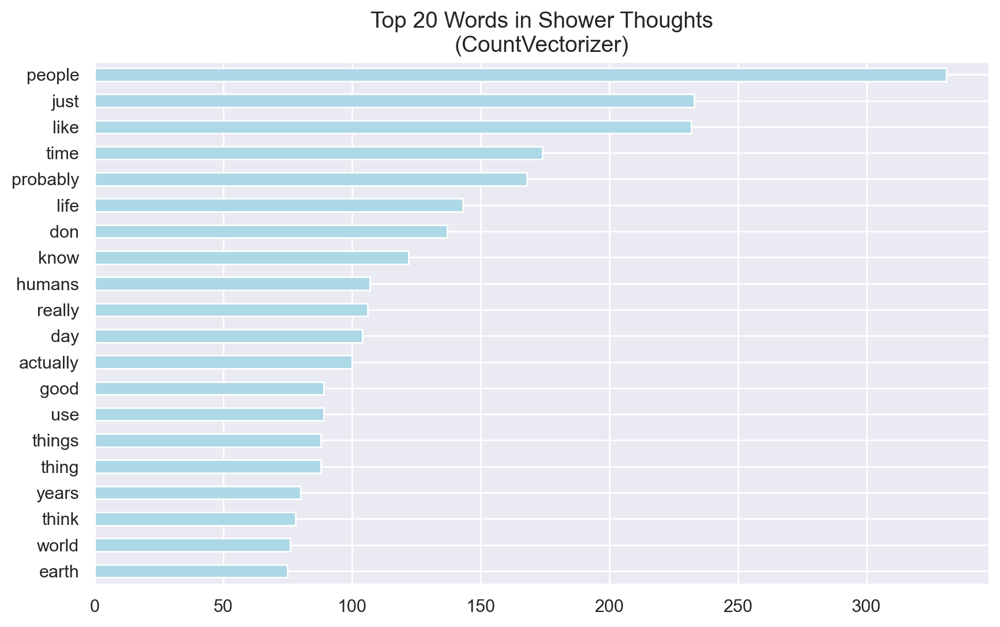

In [27]:
plt.figure(figsize = (10,6), dpi = 200)
sns.set(style="darkgrid")

top_20_shower_cvec.plot.barh(color = 'lightblue')

plt.title('Top 20 Words in Shower Thoughts\n(CountVectorizer)', fontdict = {'fontsize': 14})
plt.show();

### 4.2.1.2 Most Frequent Bigrams For Shower Thoughts

In [28]:
# Set X's and y's
shower_X2 = shower['title_self']

In [29]:
# instantiate CountVectorizer
shower_cvec2 = CountVectorizer(stop_words = 'english', ngram_range = (2,2))

In [30]:
# Fit and transform the vectorizer on our corpus.
shower_cvec2.fit(shower_X2)

# transform test and train
shower_X2 = shower_cvec2.transform(shower_X2)

In [31]:
# create shower_cvec2
shower_cvec2_df = pd.DataFrame(shower_X2.todense(), columns = shower_cvec2.get_feature_names())
shower_cvec2_df.head()

00 half  000 10  000 steps  10 000  10 gallon  10 gas  10 hotdogs  \
0        0       0          0       0          0       0           0   
1        0       0          0       0          0       0           0   
2        0       0          0       0          0       0           0   
3        0       0          0       0          0       0           0   
4        0       0          0       0          0       0           0   

   10 sites  10 syllables  10 years  100 chance  100 pennies  100 years  \
0         0             0         0           0            0          0   
1         0             0         0           0            0          0   
2         0             0         0           0            0          0   
3         0             0         0           0            0          0   
4         0             0         0           0            0          0   

   1000 thought  10x shower  115 years  12am hours  12pm 5pm  13 275g  14 75g  \
0             0           0          0           0         0        0       0   
1             0           0          0           0         0        0       0   
2             0           0          0           0         0        0       0   
3             0           0          0           0         0        0       0   
4             0           0          0           0         0        0       0   

   1500 1800  16 bit  18 tutorial  19 f4m  1950 70  20 battery  2012 thinking  \
0          0       0            0       0        0           0              0   
1          0       0            0       0        0           0              0   
2          0       0            0       0        0           0              0   
3          0       0            0       0        0           0              0   
4          0       0            0       0        0           0              0   

   2020 looks  2020 unsuccessfully  2020 zoo  2062 george  21st birthday  \
0           0                    0         0            0              0   
1           0                    0         0            0              0   
2           0                    0         0            0              0   
3           0                    0         0            0              0   
4           0                    0         0            0              0   

   222 snapcat  256 bit  275g titanium  2d animators  34 cards  34 rule  \
0            0        0              0             0         0        0   
1            0        0              0             0         0        0   
2            0        0              0             0         0        0   
3            0        0              0             0         0        0   
4            0        0              0             0         0        0   

   35 cents  35 lb  3d animators  3d artists  3d model  3d printers  40 years  \
0         0      0             0           0         0            0         0   
1         0      0             0           0         0            0         0   
2         0      0             0           0         0            0         0   
3         0      0             0           0         0            0         0   
4         0      0             0           0         0            0         0   

   420 dog  4d artists  500 years  50s era  5683 probably  5pm 12am  \
0        0           0          0        0              0         0   
1        0           0          0        0              0         0   
2        0           0          0        0              0         0   
3        0           0          0        0              0         0   
4        0           0          0        0              0         0   

   5pm hours  60 snoop  60 turns  63 years  64 bit  650 750  70 stupid  \
0          0         0         0         0       0        0          0   
1          0         0         0         0       0        0          0   
2          0         0         0         0       0        0          0   
3          0         0     

In [32]:
top_20_shower_cvec2 = shower_cvec2_df.sum().T.sort_values(ascending = True).tail(20)
top_20_shower_cvec2

people say           12
hate thing           12
different races      12
growing apples       12
thing matters        12
ve racist            12
look like            13
probably people      14
don want             15
video game           15
wanting use          16
good lying           16
supreme court        16
apples aren          16
really just          16
fruits vegetables    18
years ago            20
shower thoughts      23
don know             27
real life            28
dtype: int64

### Top 20 Shower Thoughts Bigrams Visualized

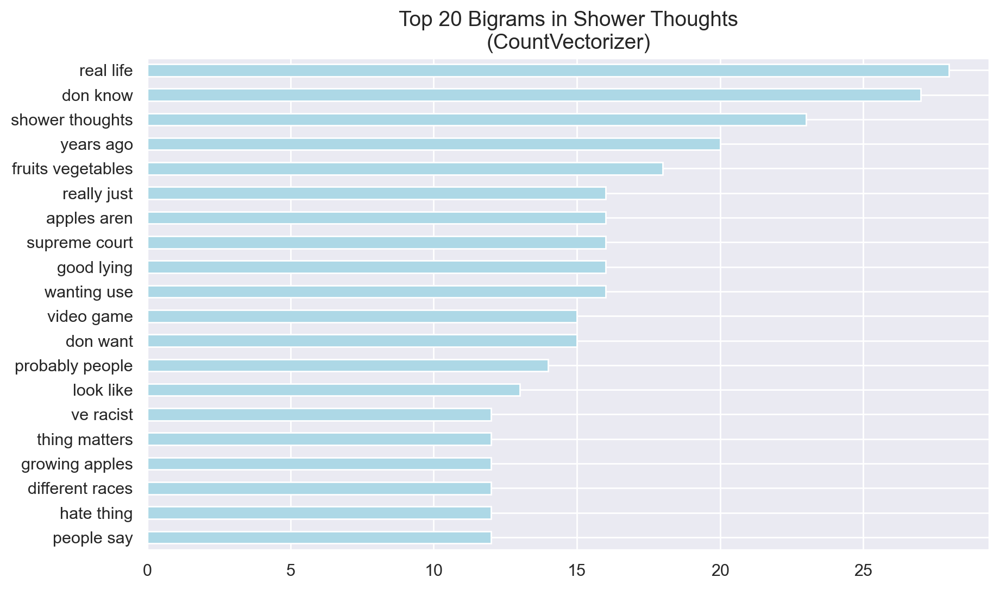

In [33]:
plt.figure(figsize = (10,6), dpi = 200)
sns.set(style="darkgrid")

top_20_shower_cvec2.plot.barh(color = 'lightblue')

plt.title('Top 20 Bigrams in Shower Thoughts\n(CountVectorizer)', fontdict = {'fontsize': 14})
plt.show();

## 4.2.2 Most Frequent Words For Intrusive Thoughts

### 4.2.2.1 Most Frequent Words For Intrusive Thoughts

In [34]:
# filter for intrusive subreddit only
intrusive = intrusive_shower[intrusive_shower['is_shower'] == 0]

In [35]:
# Set X's and y's
intrusive_X = intrusive['title_self']

In [36]:
# instantiate CountVectorizer
intrusive_cvec = CountVectorizer(stop_words = 'english')

In [37]:
# Fit and transform the vectorizer on our corpus.
intrusive_cvec.fit(intrusive_X)

# transform test and train
intrusive_X = intrusive_cvec.transform(intrusive_X)

In [38]:
# create intrusive_cvec
intrusive_cvec_df = pd.DataFrame(intrusive_X.todense(), columns = intrusive_cvec.get_feature_names())
intrusive_cvec_df.head()

,00,000,010101001010101010010110100101010101010010101010101010101001010100101010100101010101010100010010101010101010011001010101010101001010101010100101010101010101010100101010101010101001010101010010100101001010101010100101010101010010101010100101010101000101010010101010101001010100101010101001010100101010,01010100101010101010010101010101010101,10,100,1000,1000557700597,100mg,100mph,100r,10mg,10pm,11,113kmh,11688430,12,120,120mph,13,13ish,14,14m,15,15y,16,1626254346,1639852293,16f,16m,16yr,17,18,18f,19,1900s,1945,1970s,1986,1993,19f,19y,1st,20,2005,2015,2017,2018,2019,2020,2021,2022,2026,2070,20f,20m,20mg,20r,20s,20x,20y,21,21m,21st,22,22f,23,23m,24,24m,24th,25,25f,25m,25mg,25th,26m,273,28,29,2ahukewikhlvgsr31ahwksvybhzvidr0qwqsbegqiaxad,2mg,2mo,2months,2nd,2weeks,30,300,30s,31,32f,33,330am,34,35,350,36,38,3am,3kpb2yw,3pm,3rd,3x,40,400k,40s,42,43,45,49,4am,4b,4m,4s,4th,50,5050,50mg,50x,55,57,59,5am,5dreams,5ft,5htp,5kg,5th,5x,60,60hrs,60mph,65,666,6th,6yrs,70,70g,70mph,74,75,78,79,80,800,8255,83,85,88,89,8d,8inch,8th,90,900,91,911,94,988,99,9th,_00doafljzkvegmu,_8gmast7vrjv3tqv,___,_____,_cvxyi4pvvbvdfbh,_die,aaa,aaaaaaaaaaaaa,aaaaaaaaaaaaaaaaaaaa,aaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaahhhhh,aaah,aaallll,aaaàaaaaaaaaaahhhhhhhhhhhhhhh,ab,abandon,abandonment,abduct,abducted,abhorrent,abide,abilify,abilities,ability,abit,ablaze,able,ablebodied,abnormal,abnormally,aboht,abruptly,absence,absent,absolute,absolutely,absolved,absorb,absorbed,abstinence,abstraction,absurd,absurdity,abt,abuse,abused,abuser,abusers,abusing,abusive,ac,acc,accelerator,accent,accept,acceptable,accepted,accepting,accepts,access,accessible,accident,accidentally,accidently,accidents,accommodating,accomplish,accomplished,accomplishments,according,account,accounts,accross,acctivities,acctraction,accuracy,accurate,accurately,accusations,accuses,accustomed,ache,achieve,achieved,achievements,achieving,aching,acid,acknowledge,acknowledging,acne,acquaintance,acquire,acquired,acquisition,acrossed,act,acted,acting,action,actions,activated,active,actively,activities,activity,actors,actresses,acts,actual,actually,acute,ad,adaa,adapt,adaptable,adapted,add,added,addict,addicted,addiction,addictions,addictive,adding,additional,additionally,address,addressed,adds,adequately,adhd,admit,admitted,admittedly,admitting,adobe,adolescents,adolf,adopt,adopted,adopting,adoptive,adorable,adoration,adore,adrenaline,ads,adult,adultbedwetting,adults,adultswim,advance,advanced,advancement,advances,advantage,advent,adventures,advice,advices,advise,advised,advisor,aesthetic,af,afab,affair,affect,affected,affecting,affection,affective,affects,affirm,affirmation,affliction,afford,aforementioned,afraid,africa,african,africanized,afterlife,aftermath,afternoon,afterward,age,aged,agent,agents,ages,aggravated,aggression,aggressive,aggressively,aggressor,agitated,ago,agonise,agonize,agonizing,agony,agree,agreed,agreeing,agreement,ah,ahead,ahem,ahhh,ahhhhhhhh,ahkbar,ahold,ahve,ai,aid,aim,aimed,ain,aint,air,airplane,airpod,airpods,airport,airtight,aita,aka,akin,al,alarm,alarmed,alarms,alcohol,alcoholic,ale,alert,alerts,alexa,ali,alien,aliens,alive,aliveeeee,allahu,allan,allegation,alleged,allegedly,allergic,allergies,allergy,alliance,allies,alll,allot,allow,allowed,allowing,allows,alluded,almighty,aloe,alof,alongside,alot,aloud,alreayd,alright,als,alter,altercation,alternative,alternatively,altogether,aluminum,alwyas,amalgamation,amazing,amazon,amber,ambiguous,ambulance,amd,amen,amend,america,american,americans,amfraid,amnesia,amniotic,amogus,amoment,amounted,amounts,amp,amplified,amputated,amy,amygdala,amyright,anal,analbugs,analysing,analysis,analyze,analyzing,anc,anchor,ancient,andy,anecdotal,anecdotes,anemia,aneurysm,angel,angels,anger,angered,angrier,angrily,angry,anguish,animal,animals,animate,animated,animation,anime,animtaed,ankle,ankles,anmyore,anne,annoyance,annoyed,annoying,annoys,anonymous,answer,answered,answers,ant,antennae,anthrax,anti,antibiotic,antibiotics,antiblac

In [39]:
top_20_intrusive_cvec = intrusive_cvec_df.sum().T.sort_values(ascending = True).tail(20)
top_20_intrusive_cvec

bad           375
things        381
going         382
stop          392
head          394
life          394
really        501
time          514
people        583
ve            618
think         618
know          753
thought       759
want          806
feel          903
don           995
intrusive    1299
like         1553
just         1634
thoughts     2100
dtype: int64

### Top 20 Intrusive Thoughts Words Visualized

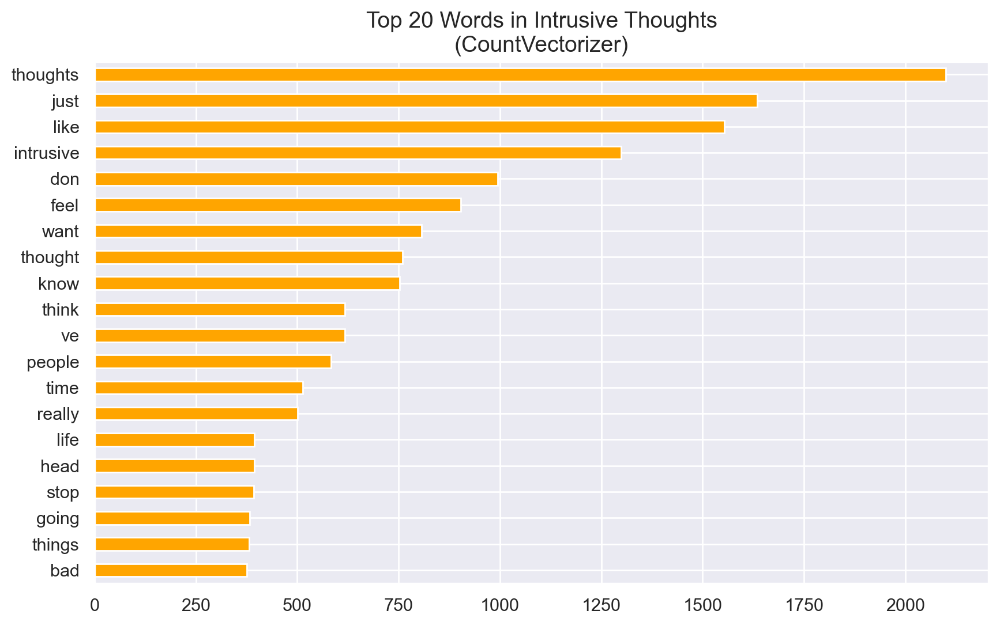

In [40]:
plt.figure(figsize = (10,6), dpi = 200)
sns.set(style="darkgrid")

top_20_intrusive_cvec.plot.barh(color = 'orange')

plt.title('Top 20 Words in Intrusive Thoughts\n(CountVectorizer)', fontdict = {'fontsize': 14})
plt.show();

### 4.2.2.2 Most Frequent Bigrams For Intrusive Thoughts

In [41]:
# Set X's and y's
intrusive_X2 = intrusive['title_self']

In [42]:
# instantiate CountVectorizer
intrusive_cvec2 = CountVectorizer(stop_words = 'english', ngram_range = (2,2))

In [43]:
# Fit and transform the vectorizer on our corpus.
intrusive_cvec2.fit(intrusive_X2)

# transform test and train
intrusive_X2 = intrusive_cvec2.transform(intrusive_X2)

In [44]:
# create intrusive_cvec2
intrusive_cvec2_df = pd.DataFrame(intrusive_X2.todense(), columns = intrusive_cvec2.get_feature_names())
intrusive_cvec2_df.head()

,00 night,000 steps,000 tired,000 years,10 00,10 11,10 13,10 14,10 broke,10 days,10 fingers,10 fold,10 groomed,10 hours,10 just,10 make,10 mins,10 minutes,10 months,10 passed,10 people,10 rank,10 seconds,10 shirt,10 times,10 years,100 100r,100 convinced,100 died,100 don,100 english,100 head,100 maximum,100 pounds,100 random,100 report,100 rob,100 starting,100 sure,100 texture,100 time,100 times,100 volume,1000 stop,100mg feel,100mg sertraline,100mg zoloft,100r exist,100r person,10pm gas,11 12,11 asked,11 im,11 know,11 manifested,11 mental,11 parents,11 pets,11 year,11 years,113kmh car,11688430 site,12 dont,12 ik,12 im,12 intrusive,12 just,12 pack,12 possibly,12 scare,12 time,12 years,120 mph,120mph 50,13 10,13 14,13 comeback,13 friend,13 gap,13 given,13 help,13 month,13 recollection,13 till,13 time,13 years,13 young,13ish billion,14 15,14 24,14 78,14 definitely,14 experience,14 female,14 getting,14 gone,14 ive,14 rn,14 sound,14 thought,14 ve,14 year,14 years,14m thoughts,15 000,15 20,15 absolutely,15 best,15 dad,15 didn,15 going,15 ig,15 mins,15 minutes,15 seconds,15 service,15 years,15y old,16 17,16 2022,16 bad,16 feeling,16 female,16 helpful,16 iv,16 just,16 year,16 years,16 yo,1626254346 ref,1639852293 jpg,16f walking,16m watching,16yr old,17 diagnosed,17 don,17 feel,17 felt,17 female,17 hated,17 online,17 showed,17 trigger,17 ve,17 year,18 22,18 24,18 explained,18 intrusive,18 life,18 longer,18 minors,18 mom,18 months,18 older,18 soon,18 thought,18 threw,18 title,18 willing,18 years,18f slept,19 entering,19 female,19 having,19 hiv,19 home,19 intrusive,19 just,19 matters,19 pandemic,19 thought,19 tits,19 work,19 years,1900s ways,1945 pittsburg,1970s era,1986 pressing,19f recently,19f study,19y old,19y struggles,1st 3rd,1st quadrant,20 21,20 days,20 little,20 lockdown,20 messed,20 minutes,20 religious,20 seconds,20 suffering,20 ve,20 years,2005 called,2015 sure,2017 remember,2018 2019,2018 intrusive,2019 actually,2019 exactly,2019 followed,2019 know,2019 unstoppable,2020 banner,2020 didn,2020 hocd,2020 intrusive,2020 lots,2020 mom,2020 started,2020 tumblr,2020 went,2021 felt,2021 finally,2021 hadn,2021 im,2021 interesting,2021 loved,2021 read,2021 relapse,2021 started,2021 symptoms,2022 current,2022 gonna,2022 sick,2022 used,2026 believed,2070 stated,20f feel,20f saw,20f ve,20m used,20mg months,20r iota,20s male,20s tip,20s want,20x day,20y old,21 26m,21m told,21st century,22 22,22 met,22 moment,22 security,22 urge,22 year,22 years,22f went,23 college,23 incredibly,23 year,23m just,24 absolutely,24 anxiety,24 brutal,24 comprehend,24 currently,24 going,24 gorilla,24 intrusive,24 know,24 like,24 ll,24 longer,24 looking,24 normal,24 obsessing,24 reconsidering,24 replay,24 ruined,24 schizophrenic,24 thoughts,24 x200b,24 yeah,24m anxiety,24m india,24m intrusive,24th 2022,25 days,25 past,25 started,25 ve,25 year,25f bf,25f husband,25m know,25mg stopping,25th decided,26m dating,26m noticed,273 8255,28 days,28 pretty,28 realized,28 year,29 alarm,29 need,29 number,29 year,2ahukewikhlvgsr31ahwksvybhzvidr0qwqsbegqiaxad usg,2mg month,2mo old,2months intrusive,2nd quadrant,2nd semester,2nd time,2weeks proposed,30 40,30 60,30 mins,30 minute,30 minutes,30 point,30 seconds,30 years,300 meters,300 person,30s diagnosed,31 expected,32f relationship,33 pages,33 years,34 night,35 years,350 income,36 people,38 000,3am sure,3am took,3am wondering,3pm left,3rd day,3rd grade,3rd person,3rd quadrant,3x week,40 000,40 says,400k life,42 says,43 hours,45 mins,49 itunes,4am awake,4am room,4b hair,4m yesterday,4s like,4th car,4th floor,4th quadrant,4th victim,50 20r,50 atheist,50 different,50 falling,50 going,50 individuals,50 mg,50 week,50 yr,5050 video,50mg sertraline,50mg upped,50x worse,55 deleted,57 fbe957112180dfe73e7f0a56c93d9d91,59 99,5am span,5dreams start,5ft tall,5htp gaba,5kg weight,5th grade,5th week,5x tired,60 30,60 bucks,60 times,60hrs week,60mph just,65 gym,666 antichrist,6th birthday,6th cover,6th floor,6th grade,6yrs guess,70 gonna,70 r

In [45]:
top_20_intrusive_cvec2 = intrusive_cvec2_df.sum().T.sort_values(ascending = True).tail(20)
top_20_intrusive_cvec2

felt like              41
nigger nigger          42
mental health          43
makes feel             44
don think              46
don like               47
years ago              50
really bad             51
thoughts just          51
having intrusive       51
feels like             56
bad person             61
thoughts like          62
stop thinking          77
just want              95
don want              167
intrusive thought     182
don know              231
feel like             261
intrusive thoughts    990
dtype: int64

### Top 20 Intrusive Thoughts Bigrams Visualized

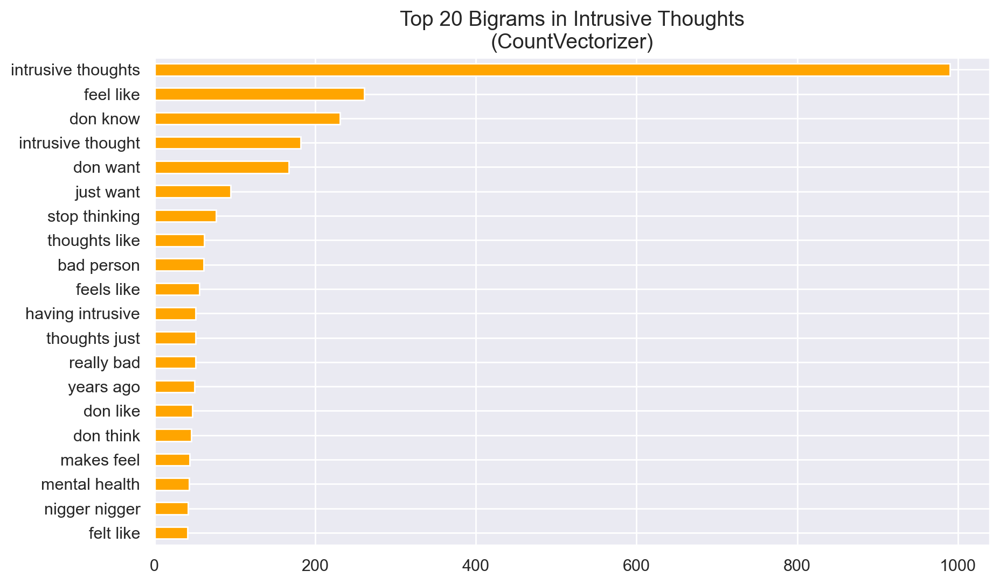

In [46]:
plt.figure(figsize = (10,6), dpi = 200)
sns.set(style="darkgrid")

top_20_intrusive_cvec2.plot.barh(color = 'orange')

plt.title('Top 20 Bigrams in Intrusive Thoughts\n(CountVectorizer)', fontdict = {'fontsize': 14})
plt.show();

# 4.3 Term Frequency-Inverse Document Frequency Vectorizer
-----
## Adapted from Lesson 5.05

In [47]:
# filter for shower subreddit only
shower = intrusive_shower[intrusive_shower['is_shower'] == 1]

# filter for intrusive subreddit only
intrusive = intrusive_shower[intrusive_shower['is_shower'] == 0]

## 4.3.2 TFIDF on Shower Thoughts

### 4.3.2.1 TFIDF Shower Thoughts Words

In [48]:
# Set X's and y's
shower_X = shower['title_self']

In [49]:
# Instantiate the transformer.
shower_tvec = TfidfVectorizer(stop_words = 'english')

In [50]:
# convert training data to dataframe
shower_tvec_df = pd.DataFrame(shower_tvec.fit_transform(shower_X).todense(), 
                          columns=shower_tvec.get_feature_names())
top_20_shower_tvec = shower_tvec_df.sum().T.sort_values(ascending = True).tail(20)
top_20_shower_tvec

think       19.390629
person      19.911411
use         20.321457
earth       20.962409
shower      21.443681
things      22.290048
actually    22.878491
thing       23.061730
good        23.497740
day         24.030264
humans      25.209435
really      25.939228
don         30.314775
know        32.256907
life        32.728456
probably    36.289394
time        38.370784
like        44.851121
just        47.546212
people      56.790344
dtype: float64

#### TFIDF Shower Thoughts Words Visualized

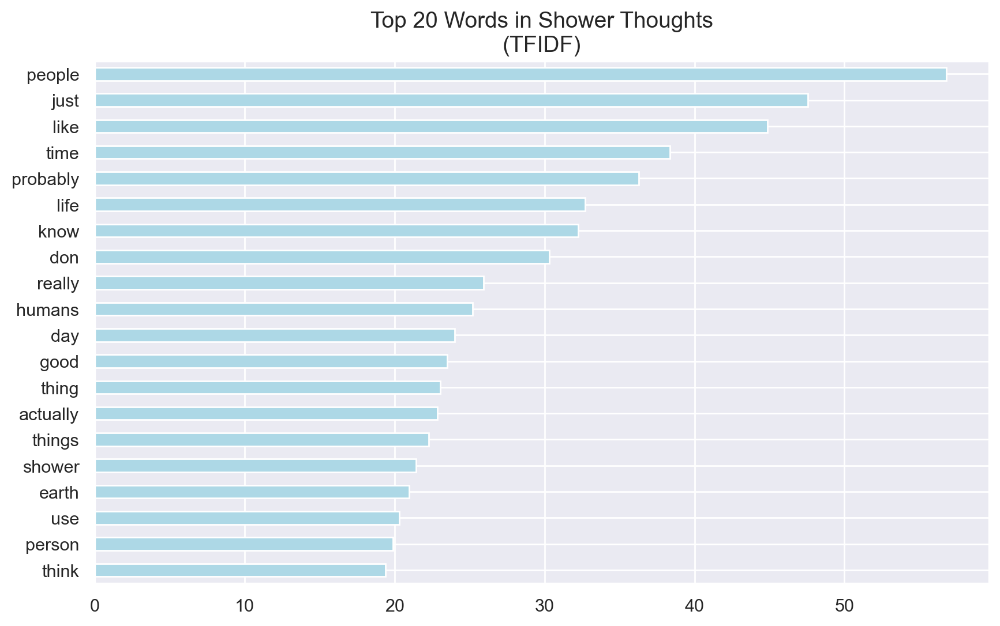

In [51]:
plt.figure(figsize = (10,6), dpi = 200)
sns.set(style="darkgrid")

top_20_shower_tvec.plot.barh(color = 'lightblue')

plt.title('Top 20 Words in Shower Thoughts\n(TFIDF)', fontdict = {'fontsize': 14})
plt.savefig('./images/tfidf_st_words.png', dpi = 200, bbox_inches='tight')
plt.savefig('./images/tfidf_st_words.jpeg', dpi = 200, bbox_inches='tight')
plt.show();

### 4.3.2.2 TFIDF Shower Thoughts Bigrams

In [52]:
# Set X's and y's
shower_X2 = shower['title_self']

In [53]:
# Instantiate the transformer.
shower_tvec2 = TfidfVectorizer(stop_words = 'english', ngram_range = (2,2))

In [54]:
# convert training data to dataframe
shower_tvec2_df = pd.DataFrame(shower_tvec2.fit_transform(shower_X2).todense(), 
                          columns=shower_tvec2.get_feature_names())
top_20_shower_tvec2 = shower_tvec2_df.sum().T.sort_values(ascending = True).tail(20)
top_20_shower_tvec2

probably people    4.550946
ve posted          4.595492
10x shower         4.595492
ones haven         4.595492
taken ones         4.595492
posted 10x         4.595492
thoughts taken     4.595492
best time          4.618802
good lying         4.618802
present best       4.618802
time alive         4.618802
women seen         4.791745
urinal lives       4.791745
vast majority      4.791745
majority women     4.791745
supreme court      5.162455
years ago          6.279697
real life          6.910365
shower thoughts    7.404136
don know           9.308986
dtype: float64

#### TFIDF Shower Thoughts Bigrams Visualized

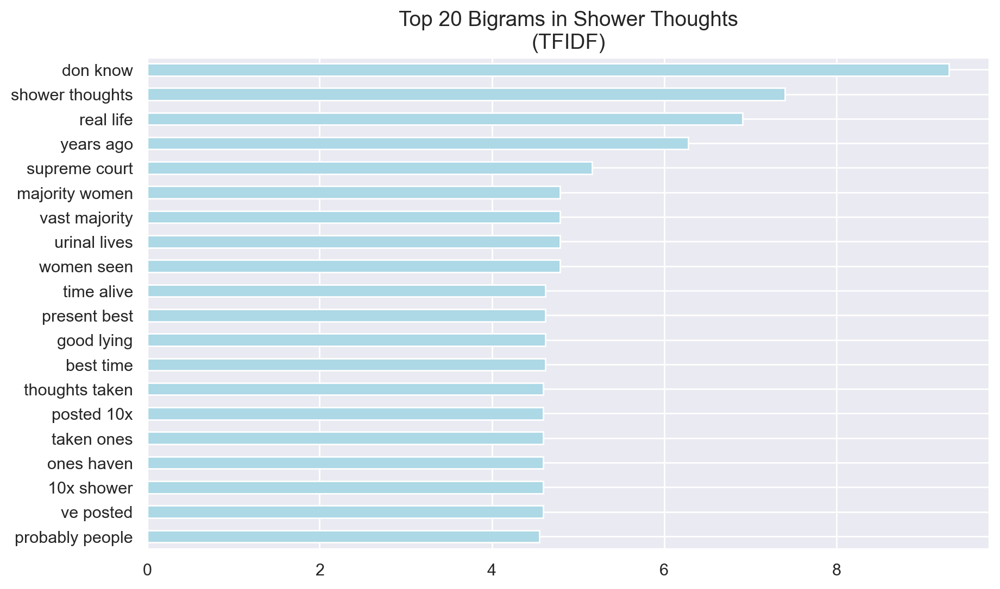

In [55]:
plt.figure(figsize = (10,6), dpi = 200)
sns.set(style="darkgrid")

top_20_shower_tvec2.plot.barh(color = 'lightblue')

plt.title('Top 20 Bigrams in Shower Thoughts\n(TFIDF)', fontdict = {'fontsize': 14})
plt.savefig('./images/tfidf_st_bigrams.png', dpi = 200, bbox_inches='tight')
plt.savefig('./images/tfidf_st_bigrams.jpeg', dpi = 200, bbox_inches='tight')
plt.show();

## 4.3.3 TFIDF on Intrusive Thoughts

### 4.3.3.1 TFIDIF Intrusive Thoughts Words

In [56]:
# Set X's and y's
intrusive_X = intrusive['title_self']

In [57]:
# Instantiate the transformer.
intrusive_tvec = TfidfVectorizer(stop_words = 'english')

In [58]:
# convert series to dataframe
intrusive_tvec_df = pd.DataFrame(intrusive_tvec.fit_transform(intrusive_X).todense(), 
                          columns=intrusive_tvec.get_feature_names())
top_20_intrusive_tvec = intrusive_tvec_df.sum().T.sort_values(ascending = True).tail(20)
top_20_intrusive_tvec

bad           31.783520
thinking      32.406744
going         33.804930
kill          35.010892
time          37.076200
head          37.924003
really        38.037608
stop          38.082203
ve            38.943322
think         42.758963
people        43.772147
know          51.125707
thought       55.499094
feel          57.932210
want          60.276517
don           66.093213
like          84.964948
intrusive     88.400388
just          98.839219
thoughts     118.533778
dtype: float64

#### TFIDF Intrusive Thoughts Words Visualized

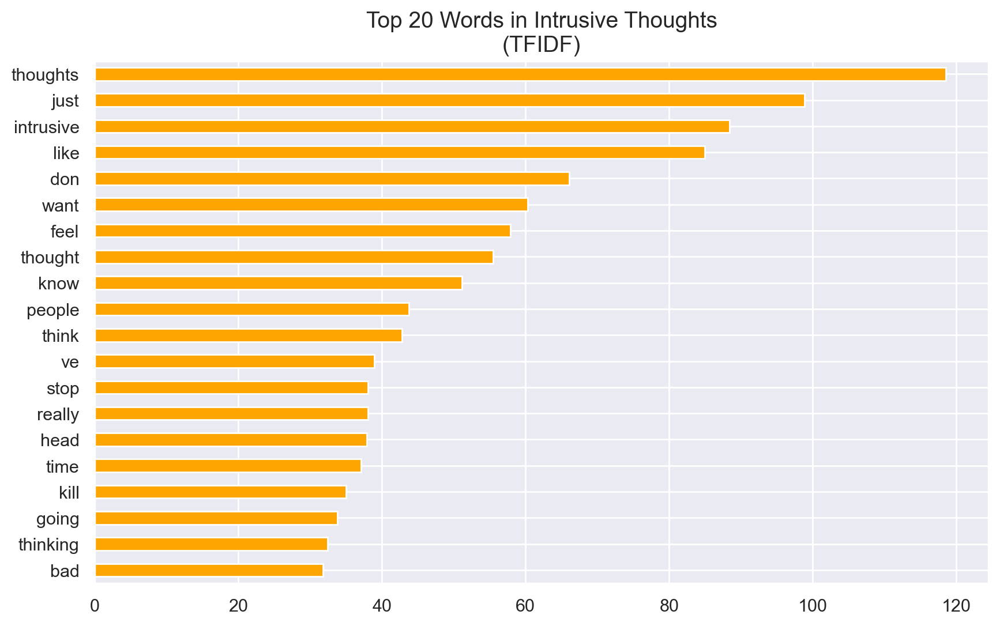

In [72]:
plt.figure(figsize = (10,6), dpi = 200)
sns.set(style="darkgrid")

top_20_intrusive_tvec.plot.barh(color = 'orange')

plt.title('Top 20 Words in Intrusive Thoughts\n(TFIDF)', fontdict = {'fontsize': 14})
plt.savefig('./images/tfidf_it_words.png', dpi = 200, bbox_inches='tight')
plt.savefig('./images/tfidf_it_words.jpeg', dpi = 200, bbox_inches='tight')
plt.show();

### 4.3.3.2 TFIDF Intrusive Thoughts Bigrams

In [60]:
# Set X's and y's
intrusive_X2 = intrusive['title_self']

In [61]:
# Instantiate the transformer.
intrusive_tvec2 = TfidfVectorizer(stop_words = 'english', ngram_range = (2,2))

In [62]:
# convert series to dataframe
intrusive_tvec2_df = pd.DataFrame(intrusive_tvec2.fit_transform(intrusive_X2).todense(), 
                          columns=intrusive_tvec2.get_feature_names())
top_20_intrusive_tvec2 = intrusive_tvec2_df.sum().T.sort_values(ascending = True).tail(20)
top_20_intrusive_tvec2

terrible person        4.071705
thoughts intrusive     4.109863
want kill              4.211842
hate hate              4.355239
throw phone            4.374782
don like               4.880213
thoughts just          4.906491
feels like             4.917764
really bad             5.023113
having intrusive       5.214260
thoughts like          6.126977
bad person             6.339210
make america           6.881845
stop thinking          8.232879
just want              8.449194
don want              11.687026
intrusive thought     15.116420
don know              15.643663
feel like             16.077284
intrusive thoughts    54.296228
dtype: float64

#### TFIDF Intrusive Thoughts Bigrams Visualized

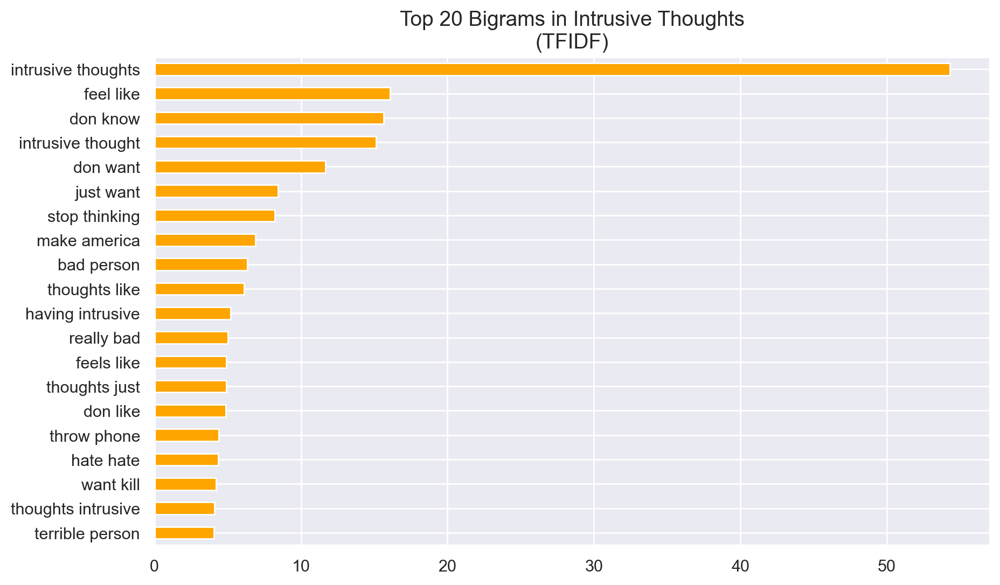

In [63]:
plt.figure(figsize = (10,6), dpi = 200)
sns.set(style="darkgrid")

top_20_intrusive_tvec2.plot.barh(color = 'orange')

plt.title('Top 20 Bigrams in Intrusive Thoughts\n(TFIDF)', fontdict = {'fontsize': 14})
plt.savefig('./images/tfidf_it_bigrams.png', dpi = 200, bbox_inches='tight')
plt.savefig('./images/tfidf_it_bigrams.jpeg', dpi = 200, bbox_inches='tight')
plt.show();

# 4.4 Save TVecs and Intrusive Shower Final
-----

In [64]:
# https://www.geeksforgeeks.org/combine-two-pandas-series-into-a-dataframe/
shower_words = pd.DataFrame(top_20_shower_tvec.index.append(top_20_shower_tvec2.index))

# rename column
shower_words.columns = ['shower_words']

# drop values that contain 'shower'
# https://www.statology.org/pandas-drop-rows-that-contain-string/
shower_words = shower_words[shower_words["shower_words"].str.contains("shower")==False]

In [65]:
intrusive_words = pd.DataFrame(top_20_intrusive_tvec.index.append(top_20_intrusive_tvec2.index))

# rename column
intrusive_words.columns = ['intrusive_words']

# drop values that contain 'intrusive'
intrusive_words = intrusive_words[intrusive_words["intrusive_words"].str.contains("intrusive")==False]

In [66]:
# https://stackoverflow.com/questions/35935670/share-variables-between-different-jupyter-notebooks

%store shower_words
%store intrusive_words

Stored 'shower_words' (DataFrame)
Stored 'intrusive_words' (DataFrame)


In [67]:
intrusive_shower.to_csv('./data/intrusive_shower_final.csv', index = False)